In [1]:
from __future__ import absolute_import
from __future__ import division
from __future__ import print_function

import os
import sys
sys.path.append(os.path.join(sys.path[0],'..','tools'))
import torch  # put this before scipy import
from mattnet import MattNet

%pylab inline
import matplotlib.pyplot as plt

from PIL import Image
import argparse
import numpy as np

from scipy.misc import imread, imresize

print(torch.cuda.current_device())
print(torch.cuda.device_count())

Populating the interactive namespace from numpy and matplotlib
0
1


In [2]:
# arguments
parser = argparse.ArgumentParser()
parser.add_argument('--dataset', type=str, default='refcoco', help='dataset name: refclef, refcoco, refcoco+, refcocog')
parser.add_argument('--splitBy', type=str, default='unc', help='splitBy: unc, google, berkeley')
parser.add_argument('--model_id', type=str, default='mrcn_cmr_with_st', help='model id name')
args = parser.parse_args('')

In [3]:
# MattNet
mattnet = MattNet(args)

/imatge/alba.herrera/maskMattnet/MAttNet/venv2/local/lib/python2.7/site-packages/torch/serialization.py:325: SourceChangeWarning: source code of class 'layers.joint_match.JointMatching' has changed. you can retrieve the original source code by accessing the object's source attribute or set `torch.nn.Module.dump_patches = True` and use the patch tool to revert the changes.
  warnings.warn(msg, SourceChangeWarning)
/imatge/alba.herrera/maskMattnet/MAttNet/venv2/local/lib/python2.7/site-packages/torch/serialization.py:325: SourceChangeWarning: source code of class 'torch.nn.modules.sparse.Embedding' has changed. you can retrieve the original source code by accessing the object's source attribute or set `torch.nn.Module.dump_patches = True` and use the patch tool to revert the changes.
  warnings.warn(msg, SourceChangeWarning)
/imatge/alba.herrera/maskMattnet/MAttNet/venv2/local/lib/python2.7/site-packages/torch/serialization.py:325: SourceChangeWarning: source code of class 'torch.nn.modu

MatNet [refcoco_unc's mrcn_cmr_with_st] loaded in 3.79 seconds.
Using config:
{'ANCHOR_RATIOS': [0.5, 1, 2],
 'ANCHOR_SCALES': [4, 8, 16, 32],
 'DATA_DIR': '/imatge/alba.herrera/maskMattnet/MAttNet/pyutils/mask-faster-rcnn/data',
 'EXP_DIR': 'res101',
 'MASK_SIZE': 14,
 'MATLAB': 'matlab',
 'MOBILENET': {'DEPTH_MULTIPLIER': 1.0,
               'FIXED_LAYERS': 5,
               'REGU_DEPTH': False,
               'WEIGHT_DECAY': 4e-05},
 'PIXEL_MEANS': array([[[102.9801, 115.9465, 122.7717]]]),
 'POOLING_ALIGN': False,
 'POOLING_MODE': 'crop',
 'POOLING_SIZE': 7,
 'RESNET': {'FIXED_BLOCKS': 1, 'MAX_POOL': False},
 'RNG_SEED': 3,
 'ROOT_DIR': '/imatge/alba.herrera/maskMattnet/MAttNet/pyutils/mask-faster-rcnn',
 'TEST': {'BBOX_REG': True,
          'HAS_RPN': True,
          'MAX_SIZE': 1000,
          'MODE': 'nms',
          'NMS': 0.3,
          'PROPOSAL_METHOD': 'gt',
          'RPN_NMS_THRESH': 0.7,
          'RPN_POST_NMS_TOP_N': 300,
          'RPN_PRE_NMS_TOP_N': 6000,
          

../tools/../pyutils/mask-faster-rcnn/lib/model/config.py:362: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  yaml_cfg = edict(yaml.load(f))


Done (t=0.69s)
creating index...
index created!
pretrained-model loaded from [../tools/../lib/mrcn/../../pyutils/mask-faster-rcnn/output/res101/coco_2014_train_minus_refer_valtest+coco_2014_valminusminival/notime/res101_mask_rcnn_iter_1250000.pth].
Mask R-CNN: imdb[coco_minus_refer], tag[notime], id[res101_mask_rcnn_iter_1250000] loaded in 5.08 seconds.


In [4]:
# box functions
def xywh_to_xyxy(boxes):
    """Convert [x y w h] box format to [x1 y1 x2 y2] format."""
    return np.hstack((boxes[:, 0:2], boxes[:, 0:2] + boxes[:, 2:4] - 1))

    
def show_boxes(img_path, boxes, colors, texts=None, masks=None):
    # boxes [[xyxy]]
    img = imread(img_path)
    plt.imshow(img)
    ax = plt.gca()
    for k in range(boxes.shape[0]):
        box = boxes[k]
        xmin, ymin, xmax, ymax = list(box)
        coords = (xmin, ymin), xmax - xmin + 1, ymax - ymin + 1
        color = colors[k]
        ax.add_patch(plt.Rectangle(*coords, fill=False, edgecolor=color, linewidth=2))
        if texts is not None:
            ax.text(xmin, ymin, texts[k], bbox={'facecolor':color, 'alpha':0.5})
    # show mask
    if masks is not None:
        for k in range(len(masks)):
            mask = masks[k]
            m = np.zeros( (mask.shape[0], mask.shape[1], 3))
            m[:,:,0] = 0; m[:,:,1] = 0; m[:,:,2] = 1.
            ax.imshow(np.dstack([m*255, mask*255*0.4]).astype(np.uint8)) 
            
def save_masks(path, query, masks):
    # show mask
    fig = plt.figure()
    ax = plt.gca()
    for k in range(len(masks)):
        mask = masks[k]
        ax.imshow(mask*255, cmap ='gray') 
        result = Image.fromarray((mask * 255).astype(np.uint8))
        result.save(os.path.join(path, query + str(k) + '.jpg'))

In [5]:
# DAVIS query information
davis = ['16', '17']
annot = ['annot1', 'annot2']

# image path
IMAGE_DIR = '../../datasets/'
PRED_DIR = '../data/DAVIS16_480p_masks/'

# expression annotations
ANNOT_DIR = '../../datasets/davis_text_annotations/'
expr = ''

a bear moving towards left


/imatge/alba.herrera/maskMattnet/MAttNet/venv2/lib/python2.7/site-packages/ipykernel_launcher.py:9: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  if __name__ == '__main__':


a black swan swimming
a man in a black helmet and a bike
a boy in a white t-shirt and a bike
a boat in the water
a boy wearing a red t-shirt and blue jeans
a boy dancing in the street
a white and blue colored bus
a camel moving
a car in the street
a white car crossing a signal
a grey car
a cow in the field
a girl wearing a white shirt and an orange skirt
a girl with blonde hair dressed in blue
a dog walking
a white and black colored dog
a car racing
a red car
a car drifting while turning
an elephant with a long trunk
a white flamingo
a grey goat
a man hiking
a guy playing hockey
a girl and a horse jumping high over obstacles
a girl riding a horse and a horse
a guy floating with kiteboard
a guy holding a kiteboard
a black dog
a girl wearing sunglasses
a duck in the green grass
a duck in the water
a guy and a bike going over a bump
a man in helmet riding a bike and a bike
two persons riding a bike and a bike
a person with a parasuit moving towards downhill
a person running through the gr

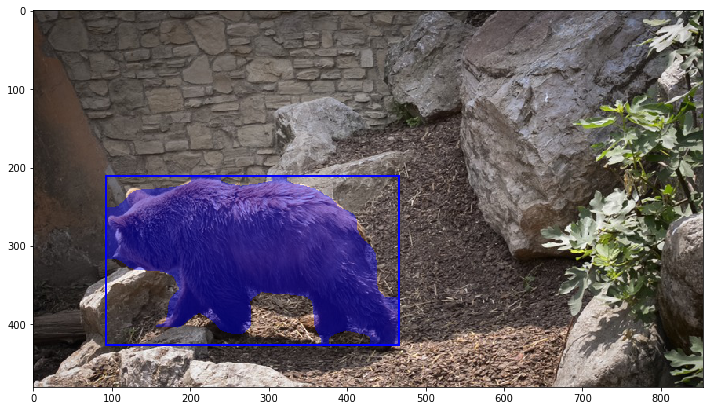

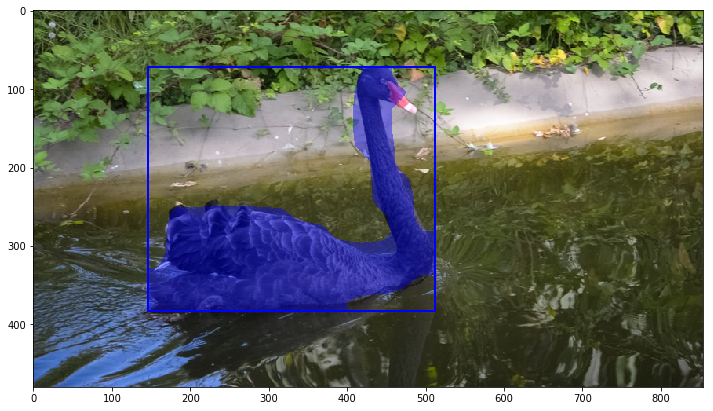

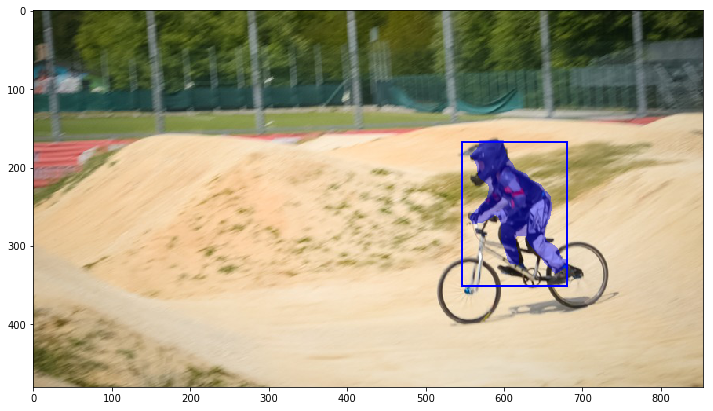

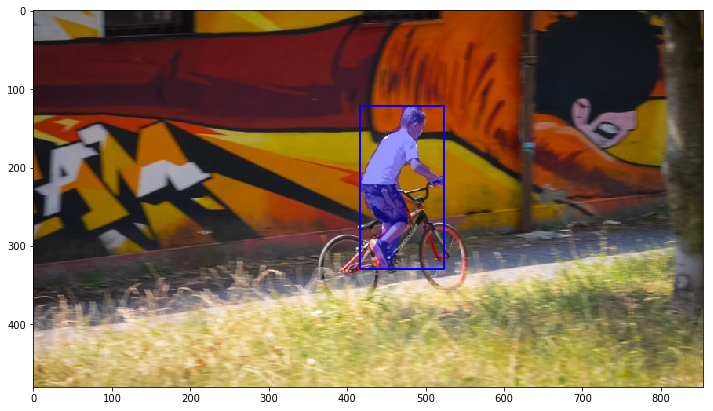

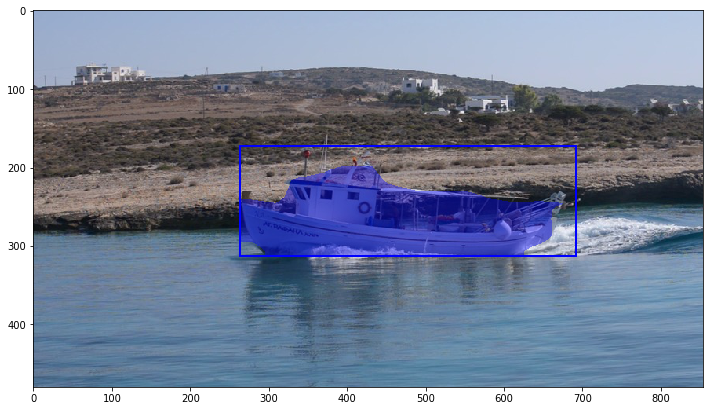

...

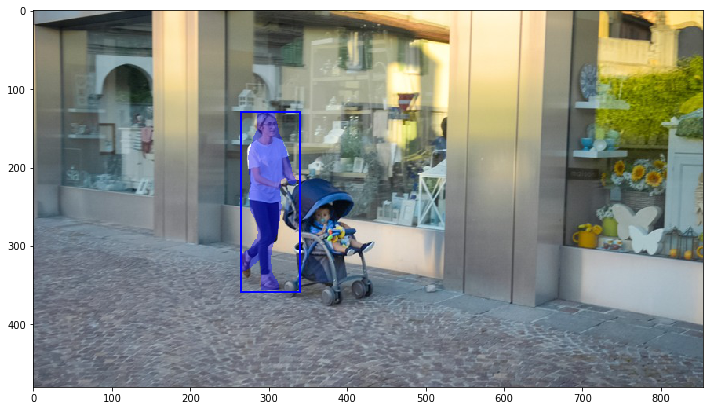

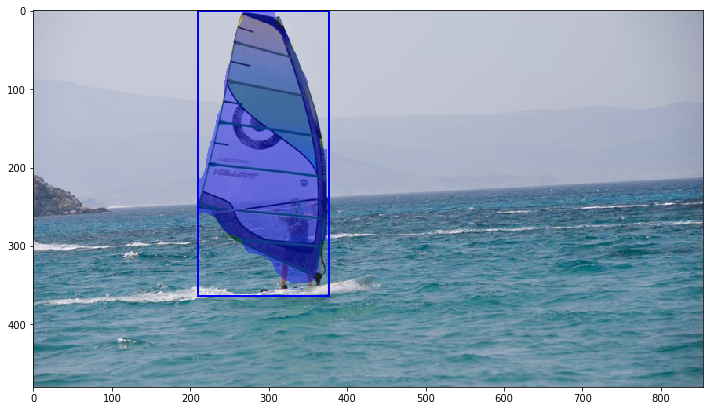

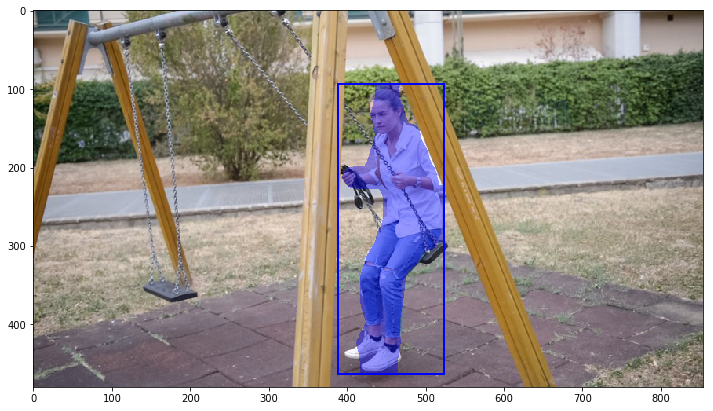

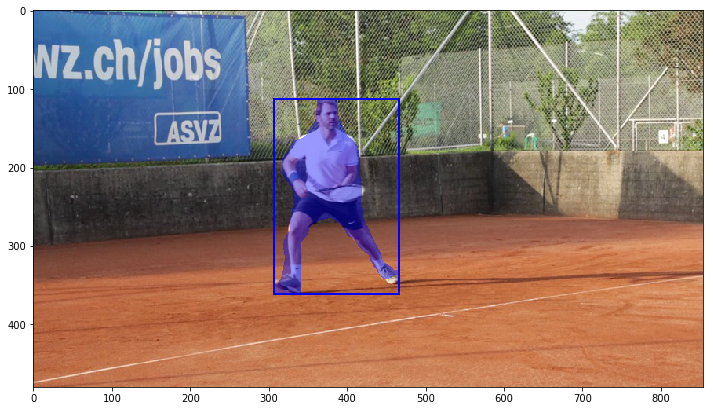

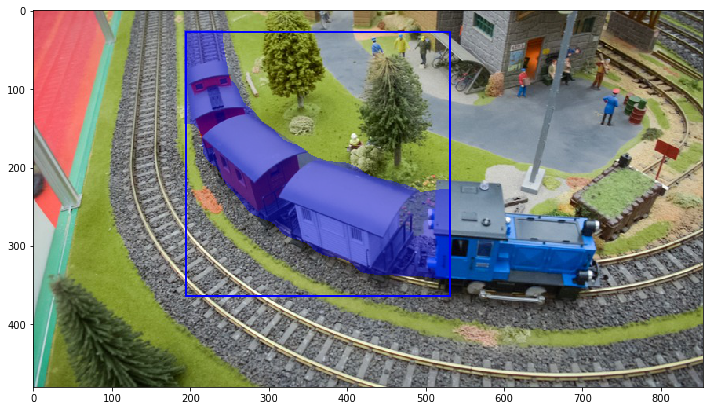

In [8]:
annotation_file = 'Davis' + davis[0] + '_' + annot[1] + '.txt'

# Open the file with read only permit
f = open( ANNOT_DIR + annotation_file)
for line in f:
    parts = line.split(' ')
    query = parts[0]
    img_path = os.path.join(IMAGE_DIR, 'DAVIS' + davis[0],'JPEGImages/480p/', query, str(0).zfill(5) + '.jpg')
    # forward image
    img_data = mattnet.forward_image(img_path, nms_thresh=0.3, conf_thresh=0.50)
    # comprehend expression
    expr = ' '.join(parts[2:]).replace('"', '').strip()
    print(expr)
    entry = mattnet.comprehend(img_data, expr)
    plt.rcParams['figure.figsize'] = (12., 8.)
    fig = plt.figure()
    show_boxes(img_path, xywh_to_xyxy(np.vstack([entry['pred_box']])), ['blue'], texts=None, masks=[entry['pred_mask']])
    # save_masks(PRED_DIR, annot[0], query, masks=[entry['pred_mask']])
f.close()
